# HHA550_Diabetes Prediction Dataset
## Healthcare-dataset-diabetes
### folder structure


In [2]:
'''
HHA550_DiabetesAnalysis/              # Root directory
    │
    ├── notebooks/                       # Jupyter notebooks
    │   ├── part_exploration.py          # Initial data analysis scripts
    │   └── part2_cleaning.py            # Data cleaning scripts
    ├── data/                           # Input data files
    │    ├── admission_source.csv       # admission source lookup table
    │    ├── admission_type.csv         # admission type lookup table
    │    ├── discharge_disposition.csv  # discharge disposition lookup table
    │    └── diabetes.csv               # Raw data file
    └── output/                          # Output data files
         └── diabetes_cleaning.csv        # Clean Data output
'''

'\nHHA550_DiabetesAnalysis/              # Root directory\n    │\n    ├── notebooks/                       # Jupyter notebooks\n    │   ├── part_exploration.py          # Initial data analysis scripts\n    │   └── part2_cleaning.py            # Data cleaning scripts\n    ├── data/                           # Input data files\n    │    ├── admission_source.csv       # admission source lookup table\n    │    ├── admission_type.csv         # admission type lookup table\n    │    ├── discharge_disposition.csv  # discharge disposition lookup table\n    │    └── diabetes.csv               # Raw data file\n    └── output/                          # Output data files\n         └── diabetes_cleaning.csv        # Clean Data output\n'

# Data
### Diabetes Prediction Dataset
## Context
####
 There are many factors that can contribute to type 2 diabetes; genetic predispositions, lifestyle factors and obesity.
 Some research suggests that these factors interact differently across ethnic groups and biological sex, and the disease is more likely to affect the male population than females.
 This analysis will evaluate whether gender, obesity, can contribute to re-admission rates. Additionally, it will examine whether obesity or biological sex influences the development of type 2 diabetes.

## Cohorts groups
 1. Diabetic patients on medication (Caucasian and African American patients)
 2. Diabetic patients not on medication (Caucasian and African American patients)

## References:
 - Schnurr TM, Jakupović H, Carrasquilla GD, et al. Obesity, unfavourable lifestyle and genetic risk of type 2 diabetes: a case-cohort study. Diabetologia. 2020;63(7):1324-1332. doi:10.1007/s00125-020-05140-5. Accessed via PubMed: https://pubmed.ncbi.nlm.nih.gov/32291466/
 - Kautzky-Willer A, Leutner M, Harreiter J. Sex differences in type 2 diabetes. Diabetologia. 2023;66(6):1165. doi:10.1007/s00125-023-05913-8. Accessed via PubMed: https://pubmed.ncbi.nlm.nih.gov/36897358/
 - Higher Prevalence of Type 2 Diabetes in Men Than in Women Is Associated With Differences in Visceral Fat Mass. J Gerontol A Biol Sci Med Sci. 2016;71(7):xxxx-xxxx. PubMed https://pubmed.ncbi.nlm.nih.gov/27490920/
 - Zhang M, Ward J, Strawbridge RJ, et al. Genetic predisposition to adiposity, and type 2 diabetes: the role of lifestyle and phenotypic adiposity. Eur J Endocrinol. 2025;192(5):549-557. doi:10.1093/ejendo/lvaf084. Accessed via PubMed: https://pubmed.ncbi.nlm.nih.gov/40315335/

# Attribute
1) gender: "Male","Female", or "Unknown"
2) age: "[0-10),"[10-20)","[20-30)","[30-40)","[40-50)","[50-60)","[60-70)","[70-80)","[80-90)","[90-100)"
3) diabetic: 0 if the patient does not have diabetes, 1 if the patiet has diabetes
4) reamitted: "NO",">30","<30"
5) diabetesMed: 0 if patient is not on diabetic medication, 1 if patient is receiving medication
6) num_procedures: indicate the number of procedures the patient recieved
7) num_medications: indicate the number of medication patient recieved
8) num_inpatient: indcate the number of inpatient visit the patient recieved
9) time_in_hospital: number of days patient was in the hospital
10) race: "Caucasian", "AfricanAmerican","Unknown","Other","Asian","Hispanic"
11) weight:"Unknown","[75-100)","[50-75)","[0-25)","[100-125)","[25-50)","[125-150)","[175-200)","[150-175)",">200"
12) admission_type: "Emergency","Urgent","Elective","Newborn","Not Available","Unknown","Trauma Center","Not Mapped"
13) A1Cresult: "None","Norm",">7",">8","Unknown"
14) discharge_disposition:
        Discharged to home
        Discharged/transferred to another short term hospital
        Discharged/transferred to SNF
        Discharged/transferred to ICF
        Discharged/transferred to another type of inpatient care institution
        Discharged/transferred to home with home health service
        Left AMA
        Discharged/transferred to home under care of Home IV provider
        Admitted as an inpatient to this hospital
        Neonate discharged to another hospital for neonatal aftercare
        Expired
        Still patient or expected to return for outpatient services
        Hospice / home
        Hospice / medical facility
        Discharged/transferred within this institution to Medicare approved swing bed
        Discharged/transferred/referred another institution for outpatient services
        Discharged/transferred/referred to this institution for outpatient services
        NULL
        Expired at home. Medicaid only, hospice.
        Expired in a medical facility. Medicaid only, hospice.
        Expired, place unknown. Medicaid only, hospice.
        Discharged/transferred to another rehab fac including rehab units of a hospital .
        Discharged/transferred to a long term care hospital.
        Discharged/transferred to a nursing facility certified under Medicaid but not certified under Medicare.
        Not Mapped
        Unknown/Invalid
        Discharged/transferred to another Type of Health Care Institution not Defined Elsewhere
        Discharged/transferred to a federal health care facility.
        Discharged/transferred/referred to a psychiatric hospital of psychiatric distinct part unit of a hospital
        Discharged/transferred to a Critical Access Hospital (CAH).
    

In [3]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction 

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
                            precision_score, recall_score, roc_auc_score,\
                            ConfusionMatrixDisplay, classification_report, RocCurveDisplay, f1_score

import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

import warnings
warnings.filterwarnings("ignore")

In [4]:

diabetic =pd.read_csv("./data/diabetic_data.csv")
diabetic.head()
diabetic.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101766 non-null  int64 
 1   patient_nbr               101766 non-null  int64 
 2   race                      101766 non-null  object
 3   gender                    101766 non-null  object
 4   age                       101766 non-null  object
 5   weight                    101766 non-null  object
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  payer_code                101766 non-null  object
 11  medical_specialty         101766 non-null  object
 12  num_lab_procedures        101766 non-null  int64 
 13  num_procedures            101766 non-null  int64 
 14  num_

In [5]:
print(f'"Number of unique patients: {diabetic["patient_nbr"].nunique()}"')
print(f'"Number of total encounters: {len(diabetic)}"')

"Number of unique patients: 71518"
"Number of total encounters: 101766"


In [6]:
px.histogram(diabetic, x="age", color="readmitted", barmode="group", title="Age Distribution by Readmission Status")


In [7]:
px.histogram(diabetic, x="race", color="readmitted", barmode="group", title="Race Distribution by Readmission Status")

In [8]:
px.histogram(diabetic, x="race", color="A1Cresult", barmode="group", title="Race Distribution by Diabetes Status")

In [65]:
y = diabetic[diabetic['race'] == 'Caucasian']['race']
counts = diabetic['race'].value_counts(dropna=False)
print(counts)
percentages = diabetic['race'].value_counts(normalize=True) * 100


print(
	"Percentage of patients race is Caucasian: %"
	f"{round(percentages.get('Caucasian', 0), 2)}  --> ({counts.get('Caucasian', 0)} encounters)\n"
	"Percentage of patients race is African American: %"
	f"{round(percentages.get('AfricanAmerican', 0), 2)} --> ({counts.get('AfricanAmerican', 0)} encounters)\n"
     "Percentage of patients race is Asisan: %"
	f"{round(percentages.get('Asian', 0), 2) }--> ({counts.get('Asian', 0)} encounters)\n"
     "Percentage of patients race is Hispanic: %"
	f"{round(percentages.get('Hispanic', 0), 2) }--> ({counts.get('Hispanic', 0)} encounters)\n"
         "Percentage of patients race is Other: %"
	f"{round(percentages.get('Other', 0), 2) }--> ({counts.get('Other', 0)} encounters)\n"
    "Percentage of patients race is Asisan, Hispanic, or Other: %"
	f"{round(percentages.get('Other', 0), 2)+ round(percentages.get('Asian', 0), 2) + round(percentages.get('Hispanic', 0), 2)}--> ({counts.get('Other', 0)+counts.get('Asian', 0)+counts.get('Hispanic', 0)} encounters)\n"
)

race
Caucasian          76099
AfricanAmerican    19210
NaN                 2273
Hispanic            2037
Other               1506
Asian                641
Name: count, dtype: int64
Percentage of patients race is Caucasian: %76.49  --> (76099 encounters)
Percentage of patients race is African American: %19.31 --> (19210 encounters)
Percentage of patients race is Asisan: %0.64--> (641 encounters)
Percentage of patients race is Hispanic: %2.05--> (2037 encounters)
Percentage of patients race is Other: %1.51--> (1506 encounters)
Percentage of patients race is Asisan, Hispanic, or Other: %4.199999999999999--> (4184 encounters)



In [10]:
y = diabetic[diabetic['readmitted'] == '<30']['readmitted']
counts = diabetic['readmitted'].value_counts()
percentages = diabetic['readmitted'].value_counts(normalize=True) * 100


print(
	"Percentage of patients wiht no readmission: %"
	f"{round(percentages.get('NO', 0), 2)}  --> ({counts.get('NO', 0)} patients)\n"
	"Percentage of patients readmitted within 30 days: %"
	f"{round(percentages.get('<30', 0), 2)} --> ({counts.get('<30', 0)} patient)\n"
    "Percentage of patients readmitted more than 30 days: %"
	f"{round(percentages.get('>30', 0), 2)}  --> ({counts.get('>30', 0)} patients)\n"
)

Percentage of patients wiht no readmission: %53.91  --> (54864 patients)
Percentage of patients readmitted within 30 days: %11.16 --> (11357 patient)
Percentage of patients readmitted more than 30 days: %34.93  --> (35545 patients)



### Check for Missing Data / Missing Values

*  Recode missing values with NaN

In [11]:
# Replace '?' representing missing values with NaN
diabetic.replace('?', np.nan, inplace=True)
diabetic.replace('None', np.nan, inplace=True)
diabetic.replace('Unknown/Invalid', np.nan, inplace=True)

'''
diabetic[['weight', 'race', 'medical_specialty']] = diabetic[['weight', 'race', 'medical_specialty']].replace('?', np.nan)
diabetic[['A1Cresult', 'max_glu_serum']] = diabetic[['A1Cresult', 'max_glu_serum']].replace('None', np.nan)
diabetic[['gender']] = diabetic[['gender']].replace('Unknown/Invalid', np.nan)
'''

"\ndiabetic[['weight', 'race', 'medical_specialty']] = diabetic[['weight', 'race', 'medical_specialty']].replace('?', np.nan)\ndiabetic[['A1Cresult', 'max_glu_serum']] = diabetic[['A1Cresult', 'max_glu_serum']].replace('None', np.nan)\ndiabetic[['gender']] = diabetic[['gender']].replace('Unknown/Invalid', np.nan)\n"

* Examine the missing data set to identify patterns

In [12]:
#Check for Missing Data/ Missing values
def missing_data_summary(df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values
missing_summary = missing_data_summary(diabetic)
print(missing_summary)

                          Missing_Number  Missing_Percent
weight                             98569         0.968585
max_glu_serum                      96420         0.947468
A1Cresult                          84748         0.832773
medical_specialty                  49949         0.490822
payer_code                         40256         0.395574
race                                2273         0.022336
diag_3                              1423         0.013983
diag_2                               358         0.003518
diag_1                                21         0.000206
gender                                 3         0.000029
time_in_hospital                       0         0.000000
admission_source_id                    0         0.000000
num_lab_procedures                     0         0.000000
encounter_id                           0         0.000000
patient_nbr                            0         0.000000
discharge_disposition_id               0         0.000000
admission_type

<Axes: >

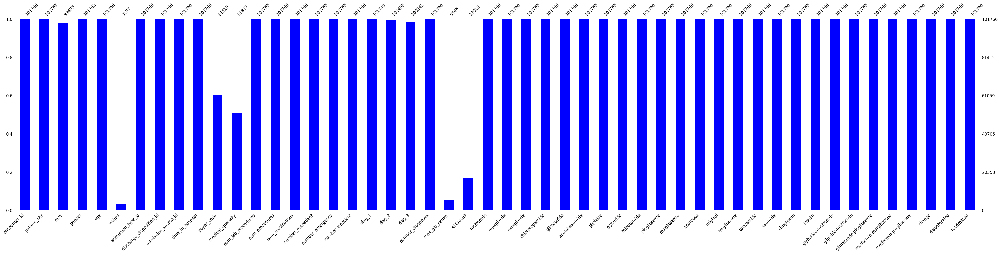

In [13]:
# Visualizing the missing data to better evaluate the data gaps and patterns of the missing data
msno.bar(diabetic, figsize=(50, 10), color='blue', fontsize=12)

<Axes: >

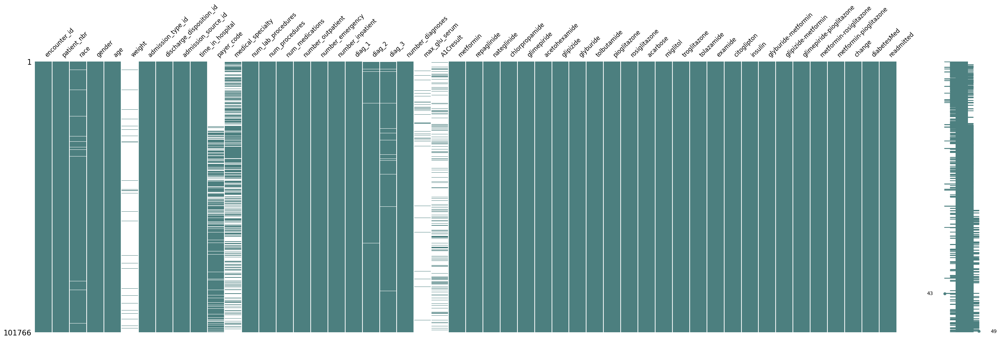

In [14]:
msno.matrix(diabetic, color=(.3, 0.5, 0.5), figsize=(35, 10), fontsize=12)

* There are lots of missing values in various fields (race,weight,medical_specialty,diagnosis,max_glu_serum,A1Cresult)
* These data inconsistencies will need to be addressed before the data analysis can be conducted.

# Exploring and Understanding the Data
Initial Insights
 - These are encounter based entries and a patient is recorded mutliple time if they have multiple reamittances.
 - Majority of the patients are of Cacucasian and African American descents, other races are underrepresented.
 - The age group with the highest number of patients is 70-80, followed by 60-70 and 80-90.
 - The majority of the patients have no readmission can be misleading as the data is encounter based and patients with multiple readmissiond will be represented multiple times in our data set.
 - The weight field is mostly empty (97% missing data), which will limit the study's ability to evaluate obesity as it relates to diabetes.

# Data Imbalance and limitations
- Due to the data imblance between demographic groups, and readmission statuses, the analysis will focus on the majority groups Caucasian and African American, and the readmission status of no readmission. The analysis will also evaluate the age group with the highest number of patients, 70-80, to determine if there are any significant trends in this age group that may contribute to diabetes development or readmission rates.
- Additionally, the analysis will remove the weight field due to the high percentage of missing values, this will limit the analysis to determine whether obesity contributing affects on diabetic patients.
* Almost 97% of the pateints are missing weight data (98569 out of 101766 encounters)
* Asian, Hispanic, Or Other patients are underrepresented in this data set, with a combind total of 4.2% of the patients (4184 out of 101766 encounters)
* The majority of the patients have no readmission, with 54.9% of the patients having no readmission (55751 out of 101766 encounters) could be a misleading statistic because the data is encounter based and multiple readmissions statuses are represnted for a single patient. Moreover, the it is not clear whether the readmission status of "NO" represents patients who were not readmitted. This could be default value for patient encounters with missing admissions information.


# Structure data between Categorical and Numerical 

# Modification for Data set from Numerical to Categorical
 - admission_type, can be translated to a categorical variable of "Emergency","Urgent","Elective","Newborn","Not Available","Unknown","Trauma Center","Not Mapped"
 - discharge_disposition, can be translated to a categorical variable of "Discharged to home","Discharged/transferred to another short term hospital","Discharged/transferred to SNF","Discharged/transferred to ICF","Discharged/transferred to another type of inpatient care institution","Discharged/transferred to home with home health service","Left AMA","Discharged/transferred to home under care of Home IV provider","Admitted as an inpatient to this hospital","Neonate discharged to another hospital for neonatal aftercare","Expired","Still patient or expected to return for outpatient services","Hospice / home","Hospice / medical facility","Discharged/transferred within this institution to Medicare approved swing bed","Discharged/transferred/referred another institution for outpatient services","Discharged/transferred/referred to this institution for outpatient services","NULL","Expired at home. Medicaid only, hospice.","Expired in a medical facility. Medicaid only, hospice.","Expired, place unknown. Medicaid only, hospice
 - admission_source_id, can be translated to a categorical variable of "Physician Referral","Clinic Referral","HMO Referral","Transfer from a hospital","Transfer from a skilled nursing facility (SNF)","Transfer from another health care facility","Emergency Room","Court/Law Enforcement","Not Available","Unknown","Transfer from critial access hospital","Transfer from other health care facility"

In [15]:
# Load the text translation files to a dataframe
admission_type_text =pd.read_csv("./data/admission_types.csv")
admission_source_text = pd.read_csv("./data/admission_source.csv")
discharge_disposition_text = pd.read_csv("./data/discharge_disposition.csv")

print(admission_type_text.head())
print(admission_source_text.head())
print(discharge_disposition_text.head())


   admission_type_id    description
0                  1      Emergency
1                  2         Urgent
2                  3       Elective
3                  4        Newborn
4                  5  Not Available
   admission_source_id                                      description
0                    1                               Physician Referral
1                    2                                  Clinic Referral
2                    3                                     HMO Referral
3                    4                         Transfer from a hospital
4                    5   Transfer from a Skilled Nursing Facility (SNF)
   discharge_disposition_id                                        description
0                         1                                 Discharged to home
1                         2  Discharged/transferred to another short term h...
2                         3                      Discharged/transferred to SNF
3                         4         

In [16]:
# Merge the text translation data to the diabetic dataframe
diabetic = diabetic.merge(
    admission_type_text[['admission_type_id', 'description']].rename(columns={'description': 'admission_type_text'}),
    how='left',
    left_on='admission_type_id',
    right_on='admission_type_id'
)
diabetic = diabetic.merge(
    admission_source_text[['admission_source_id', 'description']].rename(columns={'description': 'admission_source_text'}),
    how='left',
    left_on='admission_source_id',
    right_on='admission_source_id'
)
diabetic = diabetic.merge(
    discharge_disposition_text[['discharge_disposition_id', 'description']].rename(columns={'description': 'discharge_disposition_text'}),
    how='left',
    left_on='discharge_disposition_id',
    right_on='discharge_disposition_id'
)

In [17]:
print(diabetic[['admission_type_text', 'admission_source_text', 'discharge_disposition_text']].head())
print (f'"Admission Type Not Mapped" count: {(diabetic['admission_type_text']=='Not Mapped').sum()}')
print (f'"Admission Source Not Mapped" count: {(diabetic['admission_source_text']=='Not Mapped').sum()}')
print (f'"Discharge Disposition Not Mapped" count: {(diabetic['discharge_disposition_text']=='Not Mapped').sum()}')

  admission_type_text admission_source_text discharge_disposition_text
0                 NaN    Physician Referral                 Not Mapped
1           Emergency        Emergency Room         Discharged to home
2           Emergency        Emergency Room         Discharged to home
3           Emergency        Emergency Room         Discharged to home
4           Emergency        Emergency Room         Discharged to home
"Admission Type Not Mapped" count: 320
"Admission Source Not Mapped" count: 0
"Discharge Disposition Not Mapped" count: 989


In [18]:
diabetic.replace('Not Mapped', np.nan, inplace=True)

<Axes: >

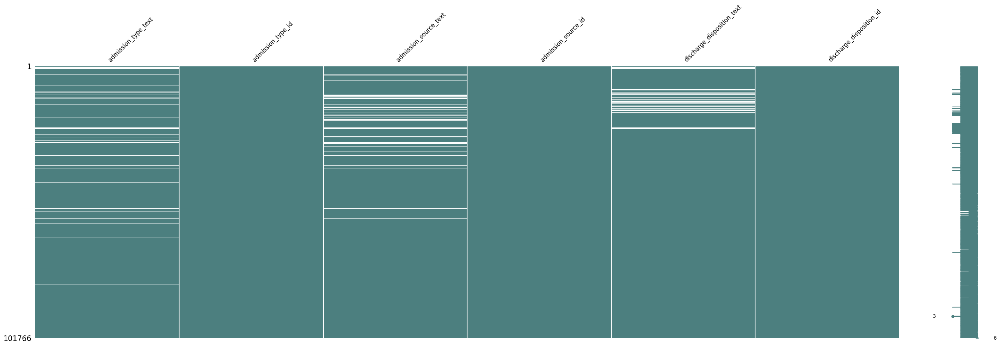

In [19]:
msno.matrix(diabetic[['admission_type_text','admission_type_id','admission_source_text','admission_source_id','discharge_disposition_text','discharge_disposition_id']], color=(.3, 0.5, 0.5), figsize=(35, 10), fontsize=12)

* Even with data that is fully populated, there may still be limiations to the analysis due to the value mismatches found in the reference text files for admission types, admission sources, and discharge dispositions. 

* Thankfully, the number of mismatched values were relatively minor comparied to the overall data set size, with less than 0.6.6% data inconsistancies found in these fields.

In [20]:
missing_summary = missing_data_summary(diabetic[['admission_type_text','admission_type_id','admission_source_text','admission_source_id','discharge_disposition_text','discharge_disposition_id']])
print(missing_summary)

                            Missing_Number  Missing_Percent
admission_source_text                 6781         0.066633
admission_type_text                   5611         0.055136
discharge_disposition_text            4680         0.045988
admission_type_id                        0         0.000000
admission_source_id                      0         0.000000
discharge_disposition_id                 0         0.000000


In [21]:

diabetic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 53 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   encounter_id                101766 non-null  int64 
 1   patient_nbr                 101766 non-null  int64 
 2   race                        99493 non-null   object
 3   gender                      101763 non-null  object
 4   age                         101766 non-null  object
 5   weight                      3197 non-null    object
 6   admission_type_id           101766 non-null  int64 
 7   discharge_disposition_id    101766 non-null  int64 
 8   admission_source_id         101766 non-null  int64 
 9   time_in_hospital            101766 non-null  int64 
 10  payer_code                  61510 non-null   object
 11  medical_specialty           51817 non-null   object
 12  num_lab_procedures          101766 non-null  int64 
 13  num_procedures              1

In [22]:
#Additional conversion of age to numerical values for easier analysis
# This will be a hard-coded mapping since the age are in ranges we will take the midpoint age value to represent the range, this is not ideal but it will get us a numerical value so we can determine skew.
age_mapping = {
    '[0-10)': 5,
    '[10-20)': 15,
    '[20-30)': 25,
    '[30-40)': 35,
    '[40-50)': 45,
    '[50-60)': 55,
    '[60-70)': 65,
    '[70-80)': 75,
    '[80-90)': 85,
    '[90-100)': 95
}
diabetic['age_value'] = diabetic['age'].map(age_mapping).astype(int)
print(diabetic['age_value'])

0          5
1         15
2         25
3         35
4         45
          ..
101761    75
101762    85
101763    75
101764    85
101765    75
Name: age_value, Length: 101766, dtype: int64


In [23]:
#Categorical fields of interest
categorical = ['race','gender','age','admission_type_text','discharge_disposition_text','A1Cresult','diabetesMed','readmitted','insulin']

#Numerical fields of interest
numerical = ['age_value','time_in_hospital','num_medications','number_outpatient','number_emergency','number_inpatient','number_diagnoses']

# Numerical fields of interest:
 - time_in_hospital
 - num_procedures
 - num_medications
 - number_outpatient
 - number_emergency
 - number_inpatient
 - number_diagnoses
 - insulin
 - age_value - This is a numerical represenstion of the age groups, utilizing the midpoint age to represent the group designated for the patient.

In [24]:
diabetic[numerical].describe()

,age_value,time_in_hospital,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,65.967022,4.395987,16.021844,0.369357,0.197836,0.635566,7.422607
std,15.940838,2.985108,8.127566,1.267265,0.930472,1.262863,1.933600
min,5.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,55.000000,2.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,65.000000,4.000000,15.000000,0.000000,0.000000,0.000000,8.000000
75%,75.000000,6.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,95.000000,14.000000,81.000000,42.000000,76.000000,21.000000,16.000000


# Skewness

In [25]:
diabetic[numerical].skew()

age_value            -0.630539
time_in_hospital      1.133999
num_medications       1.326672
number_outpatient     8.832959
number_emergency     22.855582
number_inpatient      3.614139
number_diagnoses     -0.876746
dtype: float64

array([[<Axes: title={'center': 'age_value'}>,
        <Axes: title={'center': 'time_in_hospital'}>,
        <Axes: title={'center': 'num_medications'}>],
       [<Axes: title={'center': 'number_outpatient'}>,
        <Axes: title={'center': 'number_emergency'}>,
        <Axes: title={'center': 'number_inpatient'}>],
       [<Axes: title={'center': 'number_diagnoses'}>, <Axes: >, <Axes: >]],
      dtype=object)

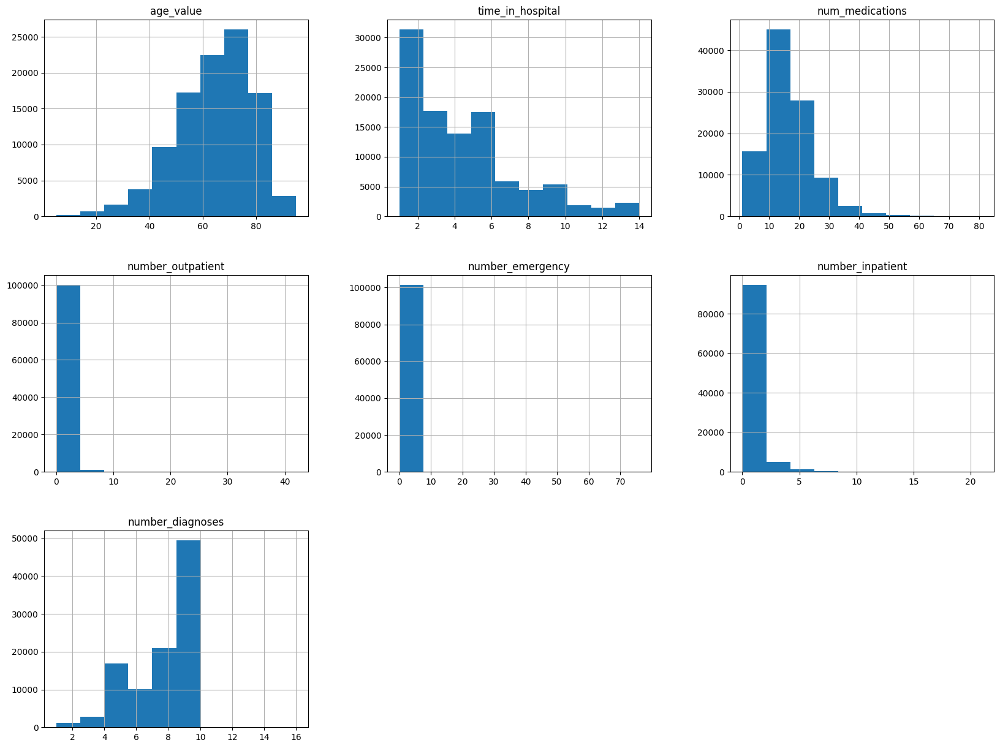

In [26]:
diabetic[numerical].hist(figsize=(20, 15))

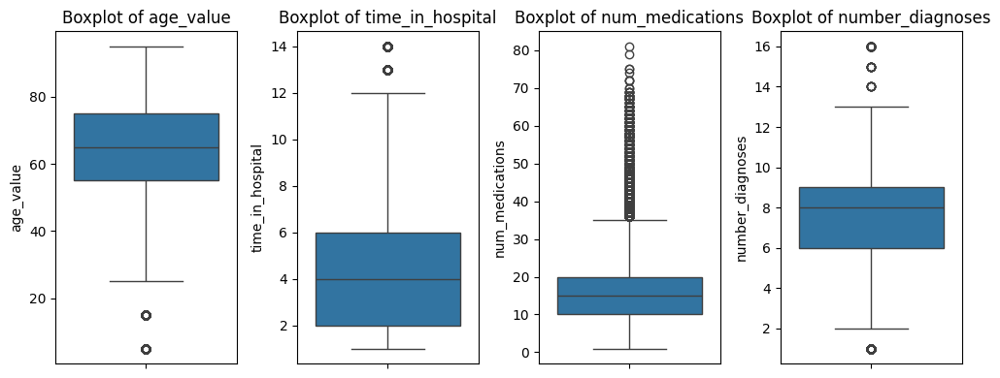

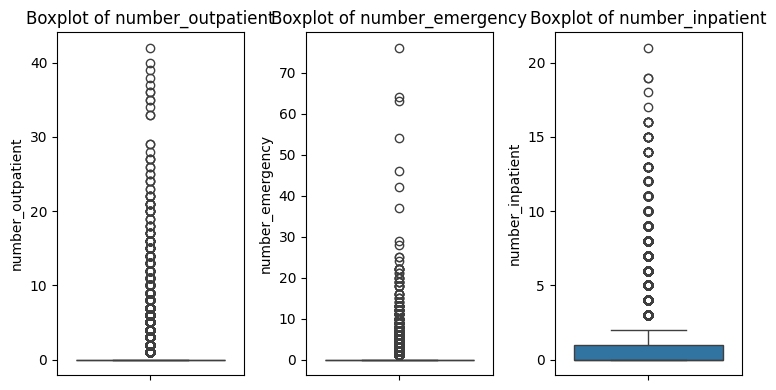

In [27]:
plt.figure(figsize=(35, 4))
for i, col in enumerate(['age_value','time_in_hospital','num_medications','number_diagnoses'], 1):
    plt.subplot(1, 14, i)
    sns.boxplot(y=diabetic[col])
    plt.title(f"Boxplot of {col}")
plt.tight_layout()
plt.show()
plt.figure(figsize=(35, 4))
for i, col in enumerate(['number_outpatient','number_emergency','number_inpatient'], 1):
    plt.subplot(1, 14, i)
    sns.boxplot(y=diabetic[col])
    plt.title(f"Boxplot of {col}")
plt.tight_layout()
plt.show()

In [28]:
# Q1 = 25th percentile
# Q3 = 75th percentile
# IQR=Q3−Q1
# Upper Bound=Q3+1.5×IQR
# Lower Bound=Q1−1.5×IQR

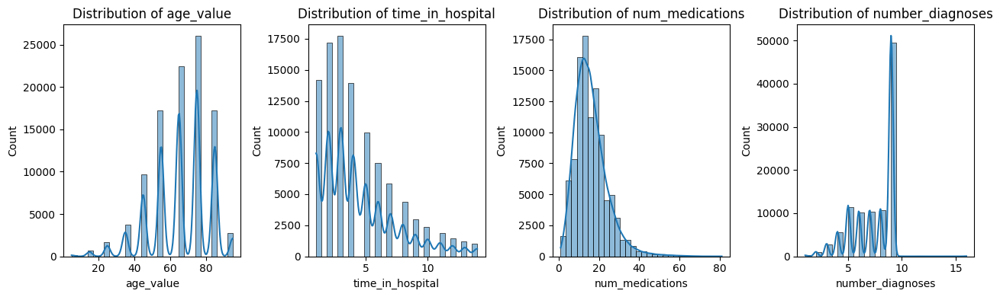

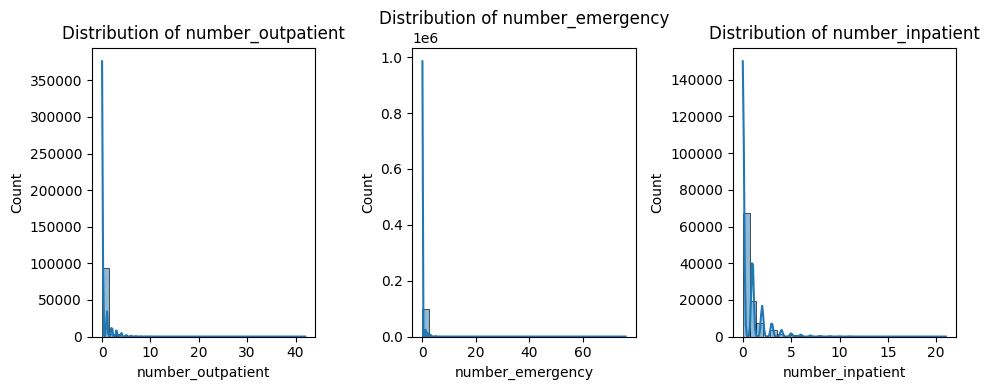

In [29]:
plt.figure(figsize=(45, 4))
for i, col in enumerate(['age_value','time_in_hospital','num_medications','number_diagnoses'], 1):
    plt.subplot(1, 14, i)
    sns.histplot(diabetic[col], kde=True, bins=30)
    plt.title(f"Distribution of {col}")
plt.tight_layout()
plt.show()
plt.figure(figsize=(45, 4))
for i, col in enumerate(['number_outpatient','number_emergency','number_inpatient'], 1):
    plt.subplot(1, 14, i)
    sns.histplot(diabetic[col], kde=True, bins=30)
    plt.title(f"Distribution of {col}")
plt.tight_layout()
plt.show()

* The left skew in age is expected since the majority of the patientes are in the older age group (range 50-80)
* The number of medications show a right skew, since the majority of the patients have range of 0-20 medications.
* The number of diangnoses is interesting, it shows a left skew, with the majority of the patientes having a range of 6-9 diangoses.This might be an indicator that these patients have multiple comorbities, which can contribute to diabetic outcomes. 
* This is furthere supported by the number of medications, showing a right skew, with highest at representations with 10-20 medications.
* The time in the hospital shows a right skew, with the majority of the patients having a range of 2-6 days in the hospital.
* The number of emergency visits shows a right skew, with many patients visits to the emergency room. This could be an indicator that the encounter based information is biased towards patients with severe conditions.

# Categorial fields of interest
- race
- gender
- age
- admission_type_text
- discharge_disposition_text
- A1Cresult
- diabetesMed
- readmitted

Race

In [30]:
print (f'{round(diabetic["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="race", title='Race', width=500, height=500)
fig.show()

race
Caucasian          76.49
AfricanAmerican    19.31
Hispanic            2.05
Other               1.51
Asian               0.64
Name: proportion, dtype: float64


Race distribution:
- Caucasian - 76.5% (76099 out of 101766 encounters)
- African American - 19.3% (1921 out of 101766 encounters)
- Hispanic - 2.05% (2037 out of 101766 encounters)
- Other - 1.51% (1506 out of 101766 encounters)
- Asian - 0.64% (641 out of 101766 encounters) 


 Gender

In [31]:
print(f'{round(diabetic["gender"].value_counts(normalize=True)*100,4)}')
fig = px.histogram(diabetic, x="gender", title='Gender', width=500, height=500)
fig.show()

gender
Female    53.7602
Male      46.2398
Name: proportion, dtype: float64


Gender distribution:
- Female - 53.8% (54708 out of 101766 encounters)
- Male - 46.3% (47055 out of 101766 encounters)

Age

In [32]:
print(f'{round(diabetic["age"].value_counts(normalize=True)*100,4)}')
fig = px.histogram(diabetic, x="age", title='Age', width=500, height=500)
fig.show()

age
[70-80)     25.6156
[60-70)     22.0928
[50-60)     16.9565
[80-90)     16.8986
[40-50)      9.5169
[30-40)      3.7095
[90-100)     2.7445
[20-30)      1.6282
[10-20)      0.6790
[0-10)       0.1582
Name: proportion, dtype: float64


Age distribution:
- 70-80 - 25.6% (26068 out of 101766 encounters)
- 60-70 - 22.09% (22486 out of 101766 encounters)
- 50-60 - 16.69% (17256 out of 101766 encounters)
- 80-90 - 16.9% (17197 out of 101766 encounters)


Admission Type

In [33]:
print(f'{round(diabetic["admission_type_text"].value_counts(normalize=True)*100,4)}')
fig = px.histogram(diabetic, x="admission_type_text", title='Admission Type', width=500, height=500)
fig.show()

admission_type_text
Emergency        56.1489
Elective         19.6235
Urgent           19.2190
Not Available     4.9763
Trauma Center     0.0218
Newborn           0.0104
Name: proportion, dtype: float64


Admission Type Destribution:
- Emergency - 56.2% (53990 out of 101766 encounters)
- Elective - 19.62% (18480 out of 101766 encounters)
- Urgent - 19.22% (18869 out of 101766 encounters)

Insulin Status

In [34]:
print(f'{round(diabetic["insulin"].value_counts(normalize=True)*100,4)}')
fig = px.histogram(diabetic, x="insulin", title='Insulin Status', width=500, height=500)
fig.show()

insulin
No        46.5607
Steady    30.3137
Down      12.0060
Up        11.1196
Name: proportion, dtype: float64


Insulin Destribution:
- No - 46.6% (47383 out of 101766 encounters)
- Steady - 30.3% (30849 out of 101766 encounters)
- Down - 12.0% (12218 out of 101766 encounters)
- Up - 11.12% (11316 out of 101766 encounters)

Discharge disposition

In [35]:
print(f'{round(diabetic["discharge_disposition_text"].value_counts(normalize=True)*100,3)}')
fig = px.histogram(diabetic, x="discharge_disposition_text", title='Discharge Disposition', width=500, height=500)
fig.show()

discharge_disposition_text
Discharged to home                                                                                           62.042
Discharged/transferred to SNF                                                                                14.373
Discharged/transferred to home with home health service                                                      13.289
Discharged/transferred to another short term hospital                                                         2.192
Discharged/transferred to another rehab fac including rehab units of a hospital .                             2.053
Expired                                                                                                       1.691
Discharged/transferred to another type of inpatient care institution                                          1.220
Discharged/transferred to ICF                                                                                 0.839
Left AMA                                     

Discharge disposition distribution:
- Discharged to home - 62% (60234 out of 101766 encounters)
- Discharged/transferred to SNF - 14.4% (13954 out of 101766 encounters)
- Discharged/transferred to home with home health service - 13.3% (12902 out of 101766 encounters)

A1Cresult

In [36]:
print(f'{round(diabetic["A1Cresult"].value_counts(normalize=True)*100,3)}')
fig = px.histogram(diabetic, x="A1Cresult", title='A1C Result', width=500, height=500)
fig.show()

A1Cresult
>8      48.278
Norm    29.322
>7      22.400
Name: proportion, dtype: float64


A1C result distribution:
- >8 - 48.3% (8216 out of 101766 encounters)
- Norm - 39.3% (4990 out of 101766 encounters)
- >7 - 22.% (3812 out of 101766 encounters) 


DiabetesMed

In [37]:
print(f'{round(diabetic["diabetesMed"].value_counts(normalize=True)*100,3)}')
fig = px.histogram(diabetic, x="diabetesMed", title='Diabetes Medication', width=500, height=500)
fig.show()

diabetesMed
Yes    77.003
No     22.997
Name: proportion, dtype: float64


Diabetes medication distribution:
- Yes diabetes medication - 77% (78363 out of 101766 encounters)
- No diabetes medication - 23% (23403 out of 101766 encounters

Readmitted

In [38]:
print(f'{round(diabetic["readmitted"].value_counts(normalize=True)*100,3)}')
fig = px.histogram(diabetic, x="readmitted", title='Readmitted', width=500, height=500)
fig.show()

readmitted
NO     53.912
>30    34.928
<30    11.160
Name: proportion, dtype: float64


 Readmission distribution:
- NO - 53.9% (54864 out of 101766 encounters)
- '>30 - 34.9% (35545 out of 101766 encounters)
- <30 - 11.2% (11357 out of 101766 encounters)

# Bivarate Analysis

In [39]:
diabetic['A1C_value']= diabetic['A1Cresult'].apply(lambda x: 1 if x in ['>7', '>8'] else (0 if x == 'Norm' else None))
print(diabetic['A1C_value'].value_counts())

A1C_value
1.0    12028
0.0     4990
Name: count, dtype: int64


Time in hospital & A1C Result

In [40]:
print (f'A person with a long hospital stay (2 or more days) has a probability of {round(diabetic[diabetic["time_in_hospital"]>1]["A1C_value"].mean()*100,2)} % to have high A1C result')

print()

print (f'A person without a long hospital stay (1 or fewer days) has a probability of  {round(diabetic[diabetic["time_in_hospital"]<=1]["A1C_value"].mean()*100,2)} % to have high A1C result')

high_a1c_stay = diabetic[diabetic["A1C_value"]==1]["time_in_hospital"].mean()
normal_a1c_stay = diabetic[diabetic["A1C_value"]==0]["time_in_hospital"].mean()

print(f'Average hospital stay for patients with HIGH A1C: {round(high_a1c_stay, 2)} days')
print(f'Average hospital stay for patients with NORMAL A1C: {round(normal_a1c_stay, 2)} days')
# Calculate percentage difference
percent_difference = ((high_a1c_stay - normal_a1c_stay) / normal_a1c_stay) * 100
if percent_difference > 0:
    print(f'Patients with HIGH A1C stay {round(percent_difference, 2)}% LONGER in the hospital compared to those with NORMAL A1C results')
else:
    print(f'Patients with NORMAL A1C stay {round(abs(percent_difference), 2)}% LONGER in the hospital compared to those with HIGH A1C results')


    

A person with a long hospital stay (2 or more days) has a probability of 70.56 % to have high A1C result

A person without a long hospital stay (1 or fewer days) has a probability of  71.67 % to have high A1C result
Average hospital stay for patients with HIGH A1C: 4.79 days
Average hospital stay for patients with NORMAL A1C: 4.92 days
Patients with NORMAL A1C stay 2.65% LONGER in the hospital compared to those with HIGH A1C results


This contradics the intial assumption that patients with higher A1C results would have a longer length of stay in the hosptial.

In [41]:
fig = px.histogram(diabetic, x="time_in_hospital", color="A1Cresult",width=600, height=400)
fig.show()
fig = px.histogram(diabetic, x="time_in_hospital", color="A1C_value",width=600, height=400)
fig.show()

Gender & A1C Result

In [42]:
print (f'A "Female" has a probability of {round(diabetic[diabetic["gender"]=="Female"]["A1C_value"].mean()*100,2)} % to have a high A1C result')

print()

print (f'A "Male" has a probability of {round(diabetic[diabetic["gender"]=="Male"]["A1C_value"].mean()*100,2)} % to have a high A1C result')

print()

print (f'A person from the "Other" category of gender has a probability of {round(diabetic[diabetic["gender"]=="Other"]["A1C_value"].mean()*100,2)} % to have a high A1C result')

A "Female" has a probability of 69.19 % to have a high A1C result

A "Male" has a probability of 72.26 % to have a high A1C result

A person from the "Other" category of gender has a probability of nan % to have a high A1C result


In [43]:
fig = px.histogram(diabetic, x="gender", color="A1C_value",width=600, height=600)
fig.show()

Race & A1C Result

In [44]:
print (f'A "Caucasian" has a probability of {round(diabetic[diabetic["race"]=="Caucasian"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A "African American" has a probability of {round(diabetic[diabetic["race"]=="AfricanAmerican"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A "Caucasian" has a probability of 70.8 % of having a high A1C result

A "African American" has a probability of 68.49 % of having a high A1C result


In [45]:
fig = px.histogram(diabetic, x="race", color="A1C_value",width=500, height=500)
fig.show()

Diabetic Medications & A1C Result

In [46]:
print (f'A patient on diabetic medications has a probability of {round(diabetic[diabetic["diabetesMed"]=="Yes"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A patient not on diabetic medications has a probability of {round(diabetic[diabetic["diabetesMed"]=="No"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A patient on diabetic medications has a probability of 73.74 % of having a high A1C result

A patient not on diabetic medications has a probability of 55.11 % of having a high A1C result


In [47]:
fig = px.histogram(diabetic, x="diabetesMed", color="A1C_value",width=500, height=500)
fig.show()

number of medications & A1C Result

In [48]:
print (f'A patient with less than 10 medications has a probability of {round(diabetic[diabetic["num_medications"]>10]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A patient with 10 or fewer medications has a probability of {round(diabetic[diabetic["num_medications"]<=10]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A patient with less than 10 medications has a probability of 70.26 % of having a high A1C result

A patient with 10 or fewer medications has a probability of 71.91 % of having a high A1C result


In [49]:
fig = px.histogram(diabetic, x="num_medications", color="A1C_value",width=500, height=500)
fig.show()

Insulin status & A1C Result

In [50]:
print (f'A patient with insulin fluctuations (up or down) has a probability of {round(diabetic[diabetic["insulin"].isin(["Up", "Down"])]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A patient with steady insulin levels has a probability of {round(diabetic[diabetic["insulin"]=="Steady"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A patient with insulin fluctuations (up or down) has a probability of 78.92 % of having a high A1C result

A patient with steady insulin levels has a probability of 71.7 % of having a high A1C result


In [51]:
fig = px.histogram(diabetic, x="insulin", color="A1C_value",width=500, height=500)
fig.show()

* Readmission status & A1C Result

In [52]:
print (f'A patient with readmission within 30 days or after 30 days has a probability of {round(diabetic[diabetic["readmitted"].isin(["<30",">30"])]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A patient with no readmission has a probability of {round(diabetic[diabetic["readmitted"]=="NO"]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A patient with readmission within 30 days or after 30 days has a probability of 72.16 % of having a high A1C result

A patient with no readmission has a probability of 69.51 % of having a high A1C result


In [53]:
fig = px.histogram(diabetic, x="readmitted", color="A1C_value",width=500, height=500)
fig.show()

discharge disposition & A1C Result

In [54]:
print (f'A patient discharged to a Skilled Nursing Facility has a probability of {round(diabetic[diabetic["discharge_disposition_id"]==3]["A1C_value"].mean()*100,2)} % of having a high A1C result')

print()

print (f'A patient discharged to home has a probability of {round(diabetic[diabetic["discharge_disposition_id"]==1]["A1C_value"].mean()*100,2)} % of having a high A1C result')

A patient discharged to a Skilled Nursing Facility has a probability of 63.55 % of having a high A1C result

A patient discharged to home has a probability of 71.91 % of having a high A1C result


In [55]:
fig = px.histogram(diabetic, x="discharge_disposition_text", color="A1C_value",width=500, height=500)
fig.show()

### Correlation Matrix & Scatter Plots

In [56]:
diabetic[numerical].corr()

,age_value,time_in_hospital,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
age_value,1.000000,0.107515,0.041847,0.023724,-0.087291,-0.042861,0.242597
time_in_hospital,0.107515,1.000000,0.466135,-0.008916,-0.009681,0.073623,0.220186
num_medications,0.041847,0.466135,1.000000,0.045197,0.013180,0.064194,0.261526
number_outpatient,0.023724,-0.008916,0.045197,1.000000,0.091459,0.107338,0.094152
number_emergency,-0.087291,-0.009681,0.013180,0.091459,1.000000,0.266559,0.055539
number_inpatient,-0.042861,0.073623,0.064194,0.107338,0.266559,1.000000,0.104710
number_diagnoses,0.242597,0.220186,0.261526,0.094152,0.055539,0.104710,1.000000


In [57]:
diabetic.groupby('A1C_value')[numerical].mean()

,age_value,time_in_hospital,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
A1C_value,,,,,,,
0.0,64.751503,4.924048,16.516232,0.255711,0.176353,0.424649,7.651503
1.0,60.473063,4.793648,16.341620,0.311606,0.177170,0.471234,7.259977


In [58]:
diabetic[['age_value','time_in_hospital','num_medications','number_diagnoses','A1C_value']].corr()

,age_value,time_in_hospital,num_medications,number_diagnoses,A1C_value
age_value,1.000000,0.107515,0.041847,0.242597,-0.110313
time_in_hospital,0.107515,1.000000,0.466135,0.220186,-0.019071
num_medications,0.041847,0.466135,1.000000,0.261526,-0.009305
number_diagnoses,0.242597,0.220186,0.261526,1.000000,-0.087841
A1C_value,-0.110313,-0.019071,-0.009305,-0.087841,1.000000


In [59]:
fig = px.scatter(diabetic, x='age_value', y='num_medications', title='Age & number of medications ',color='A1C_value', hover_data = diabetic[['readmitted']])
fig.show()

In [60]:
fig = px.scatter(diabetic, x='age_value', y='number_diagnoses', title='Age & number of diagnoses ',color='A1C_value', hover_data = diabetic[['readmitted']])
fig.show()

In [61]:
fig = px.scatter(diabetic, y='number_diagnoses', x='num_medications', title='Number of diagnoses vs Number of medications',color='A1C_value', hover_data = diabetic[['readmitted']])
fig.show()

# Clean the Data 
## 1) Drop unnecessary fields
   * Encounter_id and patient_nbr serves no purpose for this analysis
   * Weight field is 97% missing, this can be dropped
   * all medication fields (glipizide, glyburide, metformin, etc) are not need for our analysis and can be dropped
   * medical_specialty field is mostly missing, this can be dropped
   * number_outpatient, number_emergency, and number_inpatient fields are not needed for our analysis and can be dropped
## 2) Check for duplicates
    * There are no duplicate encounters in this data set.
## 3) Check for missing data
    * There are lots of missing values and imbalanced data in our data set. 
    * Will remove Asian, Hispanic, and Other patients from the analysis due to underrepresentation in the data set.
    * Will remove patients age range is under 50 and above 90 due to underrepresentation in the data set.
    * Will remove patients with discharge disposition other than "Discharged to home", "Discharged/transferred to SNF", or "Discharged/transferred to home with home health services" due to underrepresentation in the data set.
    * Will remove weight field due to 97% missing data.

In [62]:
print (diabetic.duplicated().sum())

0


In [71]:
columnsToKeep=['race',
                'gender',
                'admission_type_id','admission_type_text',
                'admission_source_id','admission_source_text',
                'discharge_disposition_id','discharge_disposition_text',
                'age','age_value',
                'A1Cresult','A1C_value',
                'diabetesMed','insulin','readmitted',
                'time_in_hospital',
                'num_medications',
                'number_diagnoses']
# Apply filters step by step and check the length
diabetic_cleaned = diabetic[columnsToKeep]
print(f"After selecting columns: {len(diabetic_cleaned)}")

diabetic_cleaned = diabetic_cleaned[diabetic_cleaned['race'].isin(['Caucasian', 'AfricanAmerican'])]
print(f"After race filter: {len(diabetic_cleaned)}")

diabetic_cleaned = diabetic_cleaned[diabetic_cleaned['age'].isin(['[50-60)', '[60-70)', '[70-80)'])]
print(f"After age filter: {len(diabetic_cleaned)}")

diabetic_cleaned = diabetic_cleaned[diabetic_cleaned['discharge_disposition_text'].isin(['Discharged to home', 'Discharged/transferred to SNF','Discharged/transferred to home with home health service'])]
print(f"After discharge disposition filter: {len(diabetic_cleaned)}")
print(f"After all filters: {len(diabetic_cleaned)/len(diabetic)*100:.2f}% is retained after cleaning")

diabetic_cleaned.to_csv('./output/diabetic_cleaning.csv', index=False)


After selecting columns: 101766
After race filter: 95309
After age filter: 61562
After discharge disposition filter: 52653
After all filters: 51.74% is retained after cleaning


"Number of total encounters: 52653"


<Axes: >

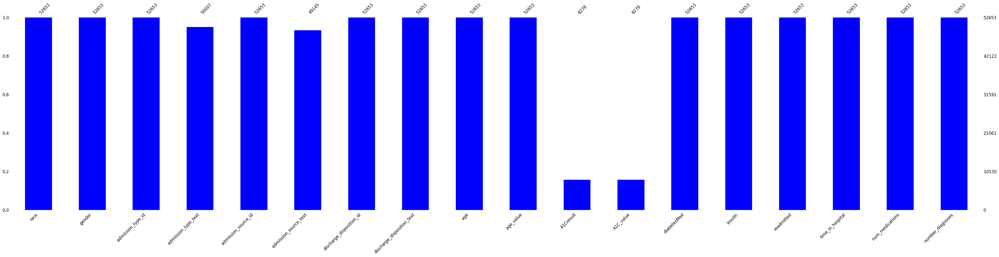

In [72]:

print(f'"Number of total encounters: {len(diabetic_cleaned)}"')
msno.bar(diabetic_cleaned, figsize=(50, 10), color='blue', fontsize=12)